In [2]:
import requests
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
from pywaffle import Waffle
import matplotlib.pylab as pylab
from matplotlib.ticker import FuncFormatter
%matplotlib inline
import numpy as np
import altair as alt
from vega_datasets import data

### The New York City 311 call database weighs 17.7 gb ( at June 25, 2023). For this reason, I filtered the calls by rodents and then downloaded it. Source: [NYC Open Data - Rats Sighting](https://data.cityofnewyork.us/Social-Services/Rat-Sightings/3q43-55fe "NYC Open Data - Rats Sighting")
### Next, I will load the database.

In [3]:
df = pd.read_csv("NYC Open Databases\Rat_Sightings.csv", low_memory=False)
df.head()

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Vehicle Type,Taxi Company Borough,Taxi Pick Up Location,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Latitude,Longitude,Location
0,15636547,01/02/2010 09:38:29 AM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,Other (Explain Below),11432.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.703342,-73.800203,"(40.70334174980328, -73.80020318978804)"
1,15636689,01/02/2010 07:09:56 AM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,Catch Basin/Sewer,11204.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.608288,-73.977775,"(40.60828832742201, -73.97777515791093)"
2,15636710,01/02/2010 09:04:46 AM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,3+ Family Mixed Use Building,11375.0,68-12 YELLOWSTON BOULEVARD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.726060,-73.848329,"(40.726059538480236, -73.84832900182792)"
3,15636731,01/02/2010 06:27:59 PM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,3+ Family Mixed Use Building,11233.0,1040 HERKIMER STREET,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.677957,-73.918921,"(40.67795748580213, -73.91892129635086)"
4,15636907,01/02/2010 12:50:16 PM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,3+ Family Apt. Building,10034.0,241 SHERMAN AVENUE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,40.866008,-73.919401,"(40.86600810878767, -73.9194006525354)"


### Let's see what columns the file "311 calls for rodents database (NYC Open Data).csv" has.

In [4]:
df.dtypes

Unique Key                          int64
Created Date                       object
Closed Date                        object
Agency                             object
Agency Name                        object
Complaint Type                     object
Descriptor                         object
Location Type                      object
Incident Zip                      float64
Incident Address                   object
Street Name                        object
Cross Street 1                     object
Cross Street 2                     object
Intersection Street 1              object
Intersection Street 2              object
Address Type                       object
City                               object
Landmark                           object
Facility Type                     float64
Status                             object
Due Date                           object
Resolution Action Updated Date     object
Community Board                    object
Borough                           

### Let's see how much rats sightings were per "city".

In [5]:
df['City'].value_counts()

City
BROOKLYN           78408
NEW YORK           57146
BRONX              40198
STATEN ISLAND       8812
Jamaica             2140
                   ...  
FORREST HILLS          1
BEDSTUY                1
BROOKYLN               1
Breezy Point           1
RICHMOND COUNTY        1
Name: count, Length: 102, dtype: int64

### Let's see which boroughs had the biggest number of complains about rats.

In [6]:
df.Borough.value_counts()

Borough
BROOKLYN         79778
MANHATTAN        58366
BRONX            40563
QUEENS           32878
STATEN ISLAND     8913
Unspecified         15
Name: count, dtype: int64

### As the database does not have a "year" column, I will extract the data from the "Created Date" column. 
### In addition, I will store it in a new column, named "year".

In [7]:
# df.groupby(by='year').Borough.value_counts().reset_index()

In [8]:
df['year'] = pd.DatetimeIndex(df['Created Date']).year
df['year']

0         2010
1         2010
2         2010
3         2010
4         2010
          ... 
220512    2023
220513    2023
220514    2023
220515    2023
220516    2023
Name: year, Length: 220517, dtype: int32

### I will group by "year" and " borough" and save it in the variable "year_borough".

In [9]:
year_borough = df.groupby('year').Borough.value_counts().reset_index()
year_borough

,year,Borough,count
0,2010,BROOKLYN,3399
1,2010,MANHATTAN,2867
2,2010,BRONX,2067
3,2010,QUEENS,1569
4,2010,STATEN ISLAND,632
...,...,...,...
70,2023,MANHATTAN,3186
71,2023,QUEENS,2073
72,2023,BRONX,1608
73,2023,STATEN ISLAND,312


### Below are the libraries installed.

In [10]:
# !pip install numpy
# !pip install altair
# !pip install vega_datasets
# !pip install altair_viewer

### Let's plot it.

In [11]:
ranges = ['yellow', 'red', 'orange', 'pink', 'purple', 'grey']

chart_year_borough = alt.Chart(year_borough, padding=15, title=alt.Title(
    "Complaints about rodents per year (2010-June 25, 2023)",
    subtitle=[],
    anchor='start',
    orient='top',
    offset=20)).mark_area().encode(
        alt.X("year").title('Years').scale(domain=(2018, 2022)).axis(format='0'),
        alt.Y("count").title('Number of Complains'),
        color=alt.Color('Borough').scale(range=ranges),
        tooltip=['Borough', 'year','count']).interactive().properties(
            width=700,
            height=600).configure_view(stroke=None).configure_axis(
            labelFontSize=13, titleFontSize=20).configure_title(fontSize=20).configure_legend(titleColor='black', 
            titleFontSize=14, labelFontSize=12, labelPadding=5, labelSeparation=5, offset=20, padding=10, 
            rowPadding=10, symbolType='square', symbolSize=150, symbolStrokeColor='black', symbolStrokeWidth=1) 

#chart_year_borough = chart_year_borough.configure_title(fontSize=20, offset=25, orient='top', anchor='start')

chart_year_borough

alt.Chart(...)

### I install "Altair saver" to be able to export in the format I need.

In [12]:
# !pip install altair_saver

In [13]:
from altair_saver import save

### I exported it as an ".html" file.

In [43]:
save(chart_year_borough, "Complaints about rodents per year (2010-June 25, 2023).html")

### How many rodent complaints were reported by "Comunity Board"? Let's find out.

In [14]:
pd.set_option('display.max_rows', None)  
df.groupby('year')['Community Board'].value_counts()

year  Community Board          
2010  Unspecified BROOKLYN          601
      07 MANHATTAN                  444
      Unspecified MANHATTAN         398
      03 BROOKLYN                   365
      Unspecified BRONX             335
      08 MANHATTAN                  304
      12 MANHATTAN                  288
      12 QUEENS                     286
      10 MANHATTAN                  279
      03 MANHATTAN                  265
      09 MANHATTAN                  254
      05 BROOKLYN                   247
      04 BRONX                      243
      04 BROOKLYN                   241
      07 BRONX                      233
      05 QUEENS                     220
      06 BROOKLYN                   216
      01 BROOKLYN                   215
      Unspecified QUEENS            214
      03 STATEN ISLAND              207
      09 BROOKLYN                   197
      01 STATEN ISLAND              180
      08 BROOKLYN                   180
      05 BRONX                      174
      17

### Let's plot it.

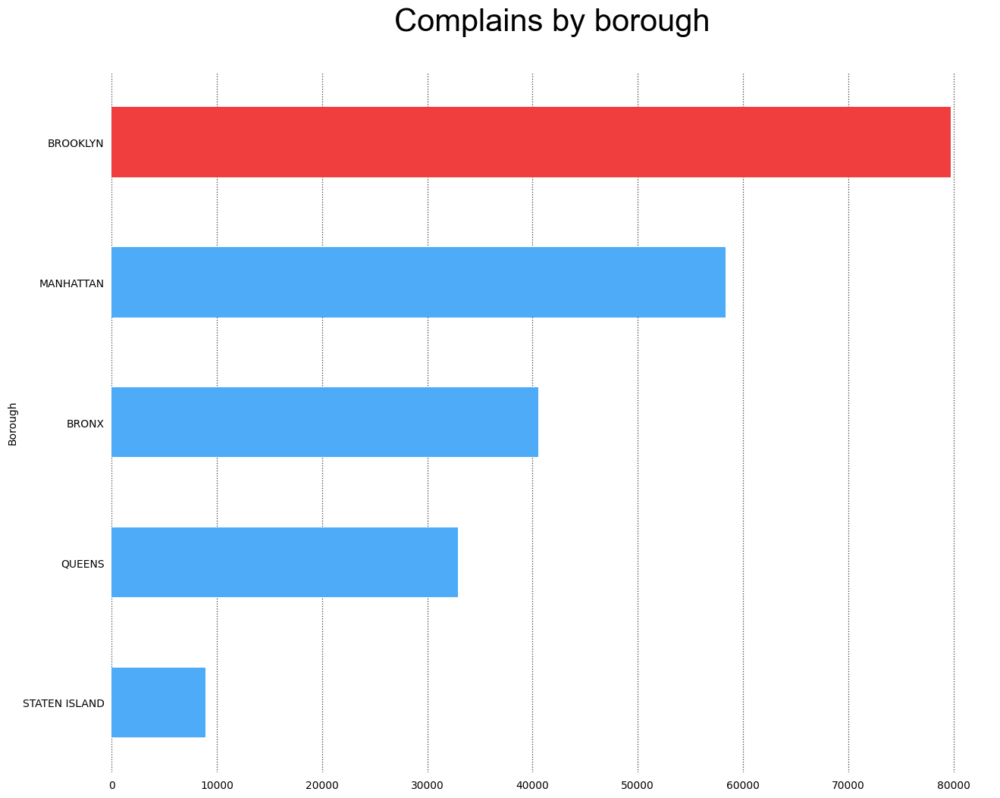

In [15]:
colors = ['#4DABF7', '#4DABF7', '#4DABF7', '#4DABF7', '#F03E3E']

ax = df.Borough.value_counts().sort_values(ascending=True).tail(5).plot(kind='barh', color=colors, figsize=(15,12))

ax.set_title('Complains by borough', pad=40)
ax.title.set_fontsize(10)

ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.title.set_fontsize(30)
ax.title.set_fontname('Arial')

ax.tick_params(which='both', left=False, bottom=False, grid_alpha=0.9)
ax.grid(True, axis='x', color='#212529', linestyle=':', linewidth=0.9)

ax.set_axisbelow(True)

plt.rcParams.update({
    'pdf.fonttype': 42,
    'ps.fonttype': 42,
    'figure.facecolor': '#F8F9FA', # colors the outside
    'axes.facecolor': '#F8F9FA', # colors the inside 
    'font.size': 12,
    'text.color': '#212529' 
})

# plt.savefig('Complains by borough.svg', dpi=300, format="svg")
# plt.savefig('Complains by borough.png', dpi=300, format="png")

### I installed "pywaffle" and then I plotted the same data in other chart.

In [16]:
# !pip install pywaffle

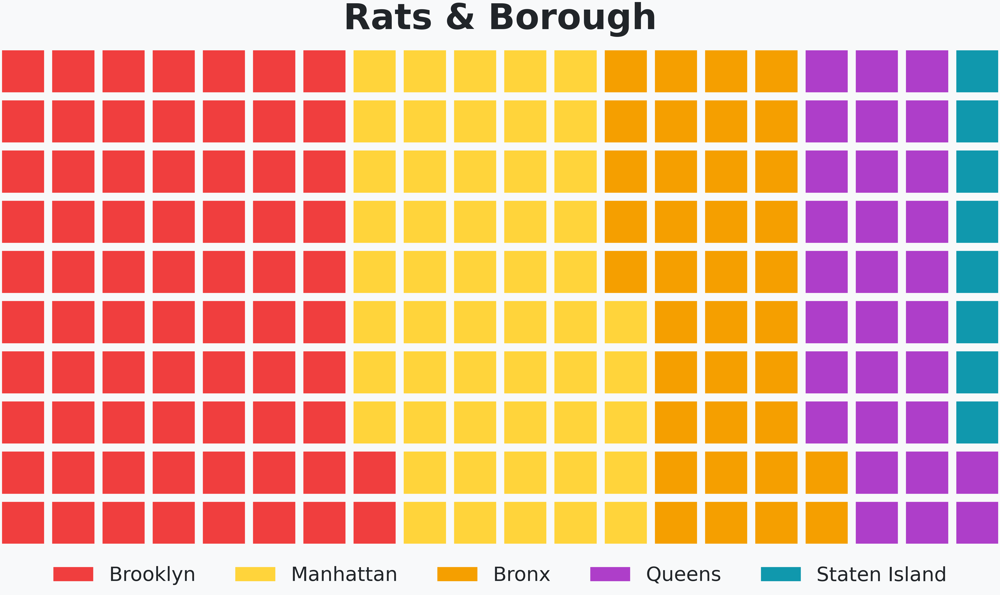

In [22]:
fig = plt.figure(
    FigureClass=Waffle, 
    rows=10,
    columns=20,
    values=df_borough.number_of_complaints,
    title=
        {
        'label': 'Rats & Borough',
        'loc': 'center',
        'pad': 75,
        'fontdict':
            {
            'fontsize': 125,
            'fontweight': 'bold'
            }
        },        
    labels=list(df_borough.borough),       
    figsize=(50, 50),
    colors=("#F03E3E", "#FFD43B", "#F59F00", "#AE3EC9", '#1098AD'),
    legend={'loc': 'lower center', 'bbox_to_anchor': (0.25, -0.10, 0.5, 0), 'fontsize': 70, 
            'framealpha': 0, 'borderaxespad': 0., 'ncol': 5}, 
    # bbox_to_anchor: (x0, y0, width, height)
)
fig.gca().set_facecolor('#fae3e3')
fig.set_facecolor('#F8F9FA')
# fig.savefig("Rats & Borough.svg", dpi=300, format="svg", bbox_inches="tight")
# fig.savefig("Rats & Borough.png", dpi=300, format="png", bbox_inches="tight")

### How many rodent complaints per borough since 2010?

In [18]:
complains_by_boroughs = df.Borough.value_counts().reset_index()
complains_by_boroughs

,Borough,count
0,BROOKLYN,79778
1,MANHATTAN,58366
2,BRONX,40563
3,QUEENS,32878
4,STATEN ISLAND,8913
5,Unspecified,15


### I saved and exported it in a ".csv" file.

In [21]:
complains_by_boroughs.to_csv('complains_by_boroughs.csv')

### How many rodent complaints were made, by borough, but adjusted for the population of each one?

In [19]:
df_borough = pd.DataFrame({'borough': ['Brooklyn', 'Manhattan', 'Bronx', 'Queens', 'Staten Island'],
    'number_of_complaints': [79778, 58366, 40563, 32878, 8913]})
df_borough

,borough,number_of_complaints
0,Brooklyn,79778
1,Manhattan,58366
2,Bronx,40563
3,Queens,32878
4,Staten Island,8913


In [20]:
df_borough_population = pd.DataFrame({'borough': ['Manhattan', 'Bronx', 'Brooklyn', 'Staten Island', 'Queens'],
    'number_of_complaints': [40563/1694251*10000, 32878/1472654*10000, 79778/2736074*10000, 8913/468730*10000, 32878/2230722*10000]})
df_borough_population

,borough,number_of_complaints
0,Manhattan,239.415529
1,Bronx,223.256787
2,Brooklyn,291.578371
3,Staten Island,190.152113
4,Queens,147.387258


### Lets plot it.

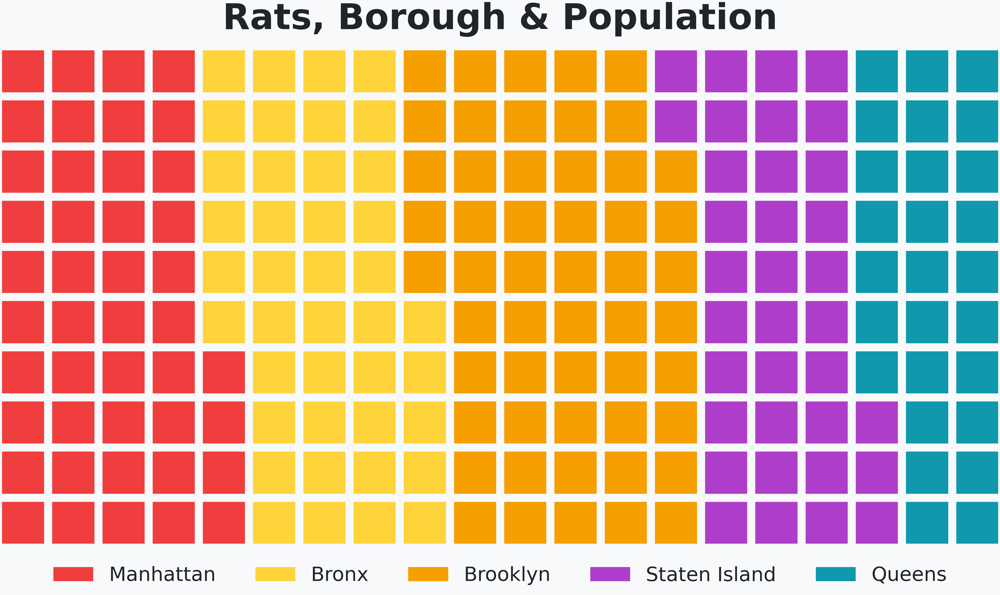

In [21]:
fig = plt.figure(
    FigureClass=Waffle, 
    rows=10,
    columns=20,
    values=df_borough_population.number_of_complaints,
    title=
        {
        'label': 'Rats, Borough & Population',
        'loc': 'center',
        'pad': 75,
        'fontdict':
            {
            'fontsize': 125,
            'fontweight': 'bold'
            }
        },        
    labels=list(df_borough_population.borough),       
    figsize=(50, 50),
    colors=("#F03E3E", "#FFD43B", "#F59F00", "#AE3EC9", '#1098AD'),
    legend={'loc': 'lower center', 'bbox_to_anchor': (0.25, -0.10, 0.5, 0), 'fontsize': 70, 
            'framealpha': 0, 'borderaxespad': 0., 'ncol': 5}, 
    # bbox_to_anchor: (x0, y0, width, height)
)
fig.gca().set_facecolor('#fae3e3')
fig.set_facecolor('#F8F9FA')
# fig.savefig("Rats, Borough & Population.svg", dpi=300, format="svg", bbox_inches="tight")
# fig.savefig("Rats, Borough & Population.png", dpi=300, format="png", bbox_inches="tight")

### I saved and exported it in a ".csv" file.

In [25]:
df_borough_population.to_csv('complains_boroughs_and_population.csv')

### Now let's see how many rodent complaints were made by "Comunity Board" and plot it.

In [23]:
df['Community Board'].value_counts()

Community Board
Unspecified BROOKLYN         10929
03 BROOKLYN                  10425
07 MANHATTAN                  9091
Unspecified MANHATTAN         8867
10 MANHATTAN                  7696
04 BROOKLYN                   6746
08 BROOKLYN                   6548
01 BROOKLYN                   6251
12 MANHATTAN                  5411
Unspecified BRONX             5014
08 MANHATTAN                  4971
05 QUEENS                     4729
03 MANHATTAN                  4715
02 BROOKLYN                   4537
04 BRONX                      4492
06 BROOKLYN                   4462
07 BRONX                      4280
09 BROOKLYN                   4017
09 MANHATTAN                  3951
05 BROOKLYN                   3904
01 STATEN ISLAND              3807
12 QUEENS                     3773
01 QUEENS                     3699
Unspecified QUEENS            3689
11 MANHATTAN                  3663
05 BRONX                      3621
09 BRONX                      3376
17 BROOKLYN                   3300
14 B

In [24]:
complains_by_cboard = df['Community Board'].value_counts().head(5)
df['Community Board'].value_counts().head(5)

Community Board
Unspecified BROOKLYN     10929
03 BROOKLYN              10425
07 MANHATTAN              9091
Unspecified MANHATTAN     8867
10 MANHATTAN              7696
Name: count, dtype: int64

<Axes: ylabel='Community Board'>

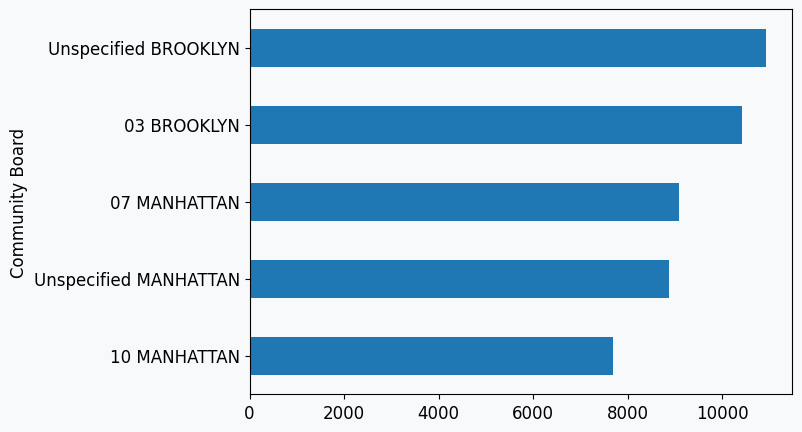

In [25]:
df['Community Board'].value_counts().head(5).sort_values(ascending=True).plot(kind='barh', figsize=(7,5))

- #### Brooklyn District 3 ("03 Brooklyn"): neighborhoods of Bedford-Stuyvesant, Stuyvesant Heights and Ocean Hill.
- #### Manhattan District 7 ("07 Manhattan"): covers a series of small neighborhoods in upper Manhattan; including Hamilton Heights, Morningside Heights, Manhattanville, Manhattan Valley, and parts of Washington Heights and the Upper West Side*. 
- #### Manhattan District 10 ("10 Manhattan"): contains all of Lower Manhattan and the Brooklyn Heights (bounded by Old Fulton Street near the Brooklyn Bridge on the north, Cadman Plaza West on the east, Atlantic Avenue on the south, and the Brooklyn–Queens Expressway or the East River on the west.), DUMBO (used to be known as Gairville.[4] It encompasses two sections: one located between the Manhattan and Brooklyn Bridges, which connect Brooklyn to Manhattan across the East River, and another that continues east from the Manhattan Bridge to the Vinegar Hill area. The neighborhood is bounded by Brooklyn Bridge Park to the north, the Brooklyn Bridge to the west, Brooklyn Heights to the south and Vinegar Hill to the east), Cobble Hill, Red Hook, Gowanus, Prospect Heights, South Slope, Park Slope, and Sunset Park neighborhoods in western Brooklyn. The district also contains portions of Borough Park and Bay Ridge in Brooklyn. 

##### *Columbia University, Riverside Church, Grant's Tomb, Morningside Park, and the northern half of Riverside Park are all located within the district.

### I saved and exported it in a ".csv" file.

In [29]:
complains_by_cboard.to_csv('complains_by_cboard.csv')

### Now let's look at what type of location, and how many rodent complaints, were made and graph it.

In [26]:
loctype_list = df['Location Type'].value_counts().head(5).reset_index()
loctype_list

,Location Type,count
0,3+ Family Apt. Building,91092
1,1-2 Family Dwelling,41584
2,Other (Explain Below),33921
3,3+ Family Mixed Use Building,14695
4,Commercial Building,12046


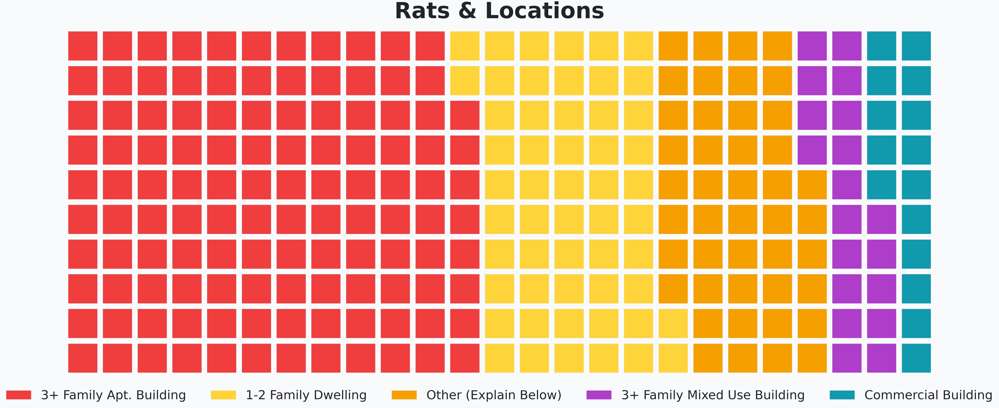

In [27]:
fig = plt.figure(
    FigureClass=Waffle, 
    rows=10,
    columns=25,
    values=loctype_list['count'],
    title=
        {
        'label': 'Rats & Locations',
        'loc': 'center',
        'pad': 75,
        'fontdict':
            {
            'fontsize': 125,
            'fontweight': 'bold'
            }
        },        
    labels=list(loctype_list['Location Type']),
    figsize=(80, 80),
    colors=("#F03E3E", "#FFD43B", "#F59F00", "#AE3EC9", '#1098AD'),
    legend={'loc': 'lower center', 'bbox_to_anchor': (0.25, -0.10, 0.5, 0), 'fontsize': 70, 
            'framealpha': 0, 'borderaxespad': 0., 'ncol': 5}, 
    # bbox_to_anchor: (x0, y0, width, height)
)
fig.gca().set_facecolor('#fae3e3')
fig.set_facecolor('#F8F9FA')
fig.savefig("Rats & Locations.svg", dpi=300, format="svg", bbox_inches="tight")
fig.savefig("Rats & Locations.png", dpi=300, format="png", bbox_inches="tight")

In [28]:
bars_loctype = alt.Chart(loctype_list).mark_bar(size=75).encode(
    x = alt.X("count", title="Number of complaints"),
    y = alt.Y('Location Type:N', title="Location Type").sort('-x'),
    color= alt.condition(
        alt.datum.count > 90000, 
        alt.value("red"),
        alt.value("steelblue"))
)

text_loctype = bars_loctype.mark_text(
    align='left',
    baseline='middle',
    dx=3,  # Nudges text to right so it doesn't appear on top of the bar
    fontStyle='bold',
    fontSize= 15
).encode(text='count:Q')

complains_loctype = (bars_loctype + text_loctype).properties(width = 'container', height = 600, 
    title = "Location Type that made complaints about rodents (2010-June 25, 2023)").configure_title(
    fontSize=20).configure_view(strokeWidth=0).configure_axis(labelFontSize=13,
    titleFontSize=18, grid=False)

complains_loctype = complains_loctype.configure_title(fontSize=20, offset=25, orient='top', anchor='start')

complains_loctype
# alt.renderers.enable('altair_viewer')
# chart.show()

alt.LayerChart(...)

### I exported it as an ".html" file.

In [220]:
complains_loctype.save('complaitns by Location Type (2010-June 25, 2023).html')

### I saved and exported it in a ".csv" file.

In [32]:
loctype_list.to_csv('complains_by_location.csv')

### Lets see wich commercial streets made the most complains and plot it.

In [29]:
commercial_streets = df[df['Location Type'] == 'Commercial Building']
commercial_streets_5 = commercial_streets['Incident Address'].value_counts().head(5).reset_index()
commercial_streets_5

,Incident Address,count
0,41-49 150 STREET,119
1,2216 VICTORY BOULEVARD,48
2,145-03 ROCKAWAY BOULEVARD,31
3,134 WEST 122 STREET,31
4,1095 ATLANTIC AVENUE,18


In [30]:
bars_commercial = alt.Chart(commercial_streets_5).mark_bar(size=75).encode(
    x = alt.X("count", title="Number of complaints"),
    y = alt.Y('Incident Address:N', title="Incident Addresses").sort('-x'),
    color= alt.condition(
        alt.datum.count > 100, 
        alt.value("red"),
        alt.value("steelblue"))
)

texts_commercial = bars_commercial.mark_text(
    align='left',
    baseline='middle',
    dx=3,  # Nudges text to right so it doesn't appear on top of the bar
    fontStyle='bold',
    fontSize= 15
).encode(text='count:Q')

commercial_complaints = (bars_commercial + texts_commercial).properties(width = 'container', height = 600, 
    title = "Commercial addresses that made complaints about rodents (2010-June 25, 2023)").configure_title(
    fontSize=20).configure_view(strokeWidth=0).configure_axis(labelFontSize=13,
    titleFontSize=18, grid=False)

commercial_complaints = commercial_complaints.configure_title(fontSize=20, offset=25, orient='top', anchor='start')

commercial_complaints

# alt.renderers.enable('altair_viewer')
# chart.show()

alt.LayerChart(...)

### I exported it as an ".html" file.

In [222]:
commercial_complaints.save('Complaints by commercial addresses (2010-June 25, 2023).html')

### I saved and exported it in a ".csv" file.

In [35]:
commercial_streets_5.to_csv('complaints_commercial_streets.csv')

### Now let's find out which residential streets made the most rodent complaints to 311 and plot it.

In [31]:
filtered_df = df[df['Location Type'].notnull()]
residential_strs = filtered_df[filtered_df['Location Type'].str.contains('Family')]

In [32]:
residential_streets = residential_strs['Street Name'].value_counts().reset_index()
residential_streets 

,Street Name,count
0,EASTERN PARKWAY,1027
1,GRAND CONCOURSE,1004
2,BROADWAY,825
3,ST JOHNS PLACE,613
4,LAFAYETTE AVENUE,606
5,BEDFORD AVENUE,602
6,PUTNAM AVENUE,598
7,JEFFERSON AVENUE,585
8,MADISON STREET,578
9,WALLACE AVENUE,572


In [33]:
bars_residential = alt.Chart(residential_streets.head(5)).mark_bar(size=75).encode(
    x = alt.X("count", title="Number of Complaints"),
    y = alt.Y('Street Name:N', title="Street Names").sort('-x'),
    color= alt.condition(
        alt.datum.count > 1000, 
        alt.value("red"),
        alt.value("steelblue"))
)

text_residential = bars_residential.mark_text(
    align='left',
    baseline='middle',
    dx=3,  # Nudges text to right so it doesn't appear on top of the bar
    fontStyle='bold',
    fontSize= 15
).encode(text='count:Q')

residential_complaints = (bars_residential + text_residential).properties(width = 'container', height = 600, 
    title = "Residential streets that made complaints about rodents (2010-June 25, 2023)").configure_title(
    fontSize=20).configure_view(strokeWidth=0).configure_axis(labelFontSize=13,
    titleFontSize=18, grid=False)

residential_complaints = residential_complaints.configure_title(fontSize=20, offset=25, orient='top', anchor='start')

residential_complaints

# alt.renderers.enable('altair_viewer')
# chart.show() 

alt.LayerChart(...)

### I exported it as an ".html" file.

In [241]:
residential_complaints.save('Complaints by residential streets (2010-June 25, 2023).html')

### I saved and exported it in a ".csv" file.

In [39]:
residential_streets.to_csv('complains_residential_streets.csv')

### I do it in another way and check the results. Also plot it.

In [34]:
df['Street Name'].value_counts()

Street Name
BROADWAY                                             1782
EASTERN PARKWAY                                      1207
GRAND CONCOURSE                                      1158
BEDFORD AVENUE                                        914
LAFAYETTE AVENUE                                      865
AMSTERDAM AVENUE                                      830
PUTNAM AVENUE                                         812
GREENE AVENUE                                         799
JEFFERSON AVENUE                                      771
ST JOHNS PLACE                                        762
LEXINGTON AVENUE                                      748
MADISON STREET                                        741
BERGEN STREET                                         728
HALSEY STREET                                         697
FULTON STREET                                         672
DEKALB AVENUE                                         670
DEAN STREET                                           653
HA

<Axes: ylabel='Street Name'>

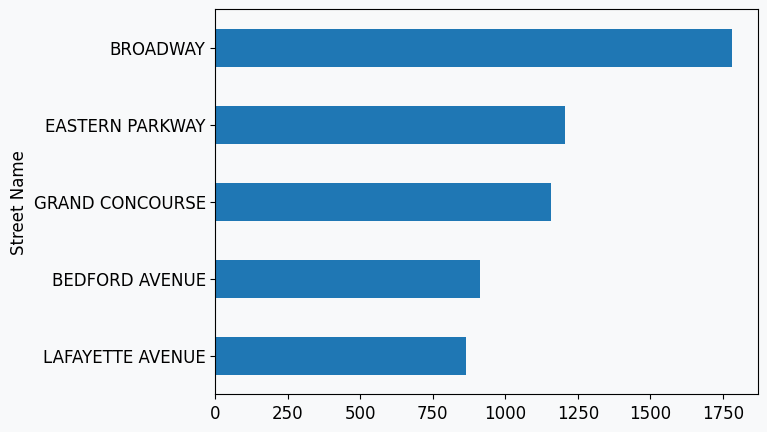

In [35]:
df['Street Name'].value_counts().head(5).sort_values(ascending=True).plot(kind='barh', figsize=(7,5))

#### Indeed, Broadway, Eastern Parkway and Grand Concourse are the streets with the most rodent complaints to 311.

In [36]:
bars_street_complaints = alt.Chart(df['Street Name'].value_counts().head(5).reset_index()).mark_bar(size=75).encode(
    x = alt.X("count", title="Number of Complaints"),
    y = alt.Y('Street Name:N', title="Street Names").sort('-x'),
    color= alt.condition(
        alt.datum.count > 1500, 
        alt.value("red"),
        alt.value("steelblue"))
)

text_street_complaints = bars_street_complaints.mark_text(
    align='left',
    baseline='middle',
    dx=3,  # Nudges text to right so it doesn't appear on top of the bar
    fontStyle='bold',
    fontSize= 15
).encode(text='count:Q')

complaints_by_street = (bars_street_complaints + text_street_complaints).properties(width = 'container', height = 600, 
    title = "Complaints about rodents by streets (2010-June 25, 2023)").configure_title(
    fontSize=20).configure_view(strokeWidth=0).configure_axis(labelFontSize=13,
    titleFontSize=18, grid=False)

complaints_by_street = complaints_by_street.configure_title(fontSize=20, offset=25, orient='top', anchor='start')

complaints_by_street

# alt.renderers.enable('altair_viewer')
# chart.show() 

alt.LayerChart(...)

### I exported it as an ".html" file.

In [256]:
complaints_by_street.save('Complaints about rodents by streets (2010-June 25, 2023).html')

### Let's see which address had the most rodent incidents.

In [182]:
df['Incident Address'].value_counts()

Incident Address
2131 WALLACE AVENUE                                     313
95 EASTERN PARKWAY                                      256
651 BROOKLYN AVENUE                                     177
410 EASTERN PARKWAY                                     150
1912 AVENUE H                                           137
BROADWAY                                                128
41-49 150 STREET                                        119
557 MONTGOMERY STREET                                   117
407 LINCOLN PLACE                                       109
120 WEST   94 STREET                                     95
2486 DAVIDSON AVE                                        90
28 MARKET STREET                                         90
AMSTERDAM AVENUE                                         89
241 WEST  116 STREET                                     85
1025 BOYNTON AVENUE                                      83
239 WEST  116 STREET                                     80
76 ST NICHOLAS PLACE   

### People are complaining more year after year? 

In [183]:
complains_per_year = df.year.value_counts()
complains_per_year

year
2022    26500
2021    25012
2017    19152
2018    17353
2016    17230
2019    16808
2020    16262
2015    15286
2014    12617
2023    11927
2013    10739
2012    10643
2010    10534
2011    10454
Name: count, dtype: int64

<Axes: ylabel='year'>

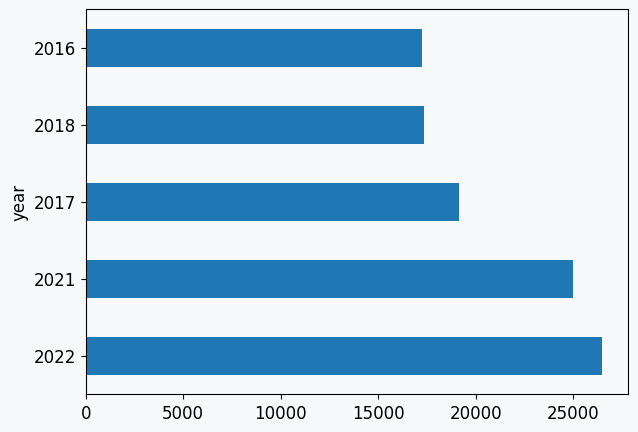

In [184]:
complains_per_year.head(5).plot(kind='barh', figsize=(7,5))

#### There is no upward pattern year after year. It is clear that complaints decreased during 2020, due to the Coronavirus Pandemic. However, in 2021 and 2022, complaint records were broken.

### When do people complain the most? Is there a repeating pattern? Let's find out.

In [185]:
df['month'] = df['Created Date'].str.extract(r'([0-9][0-9])/', expand=True)
df.head()

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Taxi Pick Up Location,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Latitude,Longitude,Location,year,month
0,15636547,01/02/2010 09:38:29 AM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,Other (Explain Below),11432.0,NaN,...,NaN,NaN,NaN,NaN,NaN,40.703342,-73.800203,"(40.70334174980328, -73.80020318978804)",2010,01
1,15636689,01/02/2010 07:09:56 AM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,Catch Basin/Sewer,11204.0,NaN,...,NaN,NaN,NaN,NaN,NaN,40.608288,-73.977775,"(40.60828832742201, -73.97777515791093)",2010,01
2,15636710,01/02/2010 09:04:46 AM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,3+ Family Mixed Use Building,11375.0,68-12 YELLOWSTON BOULEVARD,...,NaN,NaN,NaN,NaN,NaN,40.726060,-73.848329,"(40.726059538480236, -73.84832900182792)",2010,01
3,15636731,01/02/2010 06:27:59 PM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,3+ Family Mixed Use Building,11233.0,1040 HERKIMER STREET,...,NaN,NaN,NaN,NaN,NaN,40.677957,-73.918921,"(40.67795748580213, -73.91892129635086)",2010,01
4,15636907,01/02/2010 12:50:16 PM,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,3+ Family Apt. Building,10034.0,241 SHERMAN AVENUE,...,NaN,NaN,NaN,NaN,NaN,40.866008,-73.919401,"(40.86600810878767, -73.9194006525354)",2010,01


In [186]:
# pd.to_datetime(df['Created Date']).dt.month.value_counts()

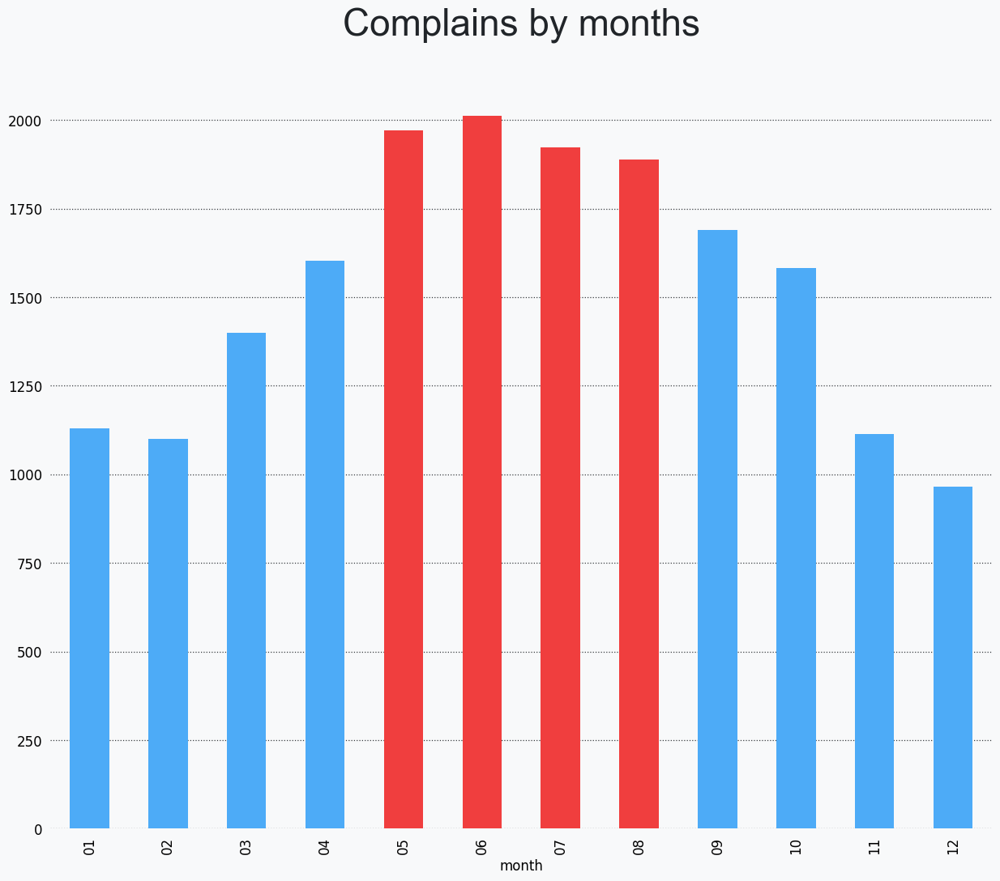

In [187]:
colors = ['#4DABF7', '#4DABF7', '#4DABF7', '#4DABF7', '#F03E3E', '#F03E3E', '#F03E3E', '#F03E3E']

ax = (df.month.value_counts() / 12).sort_index().plot(kind='bar', color=colors, figsize=(15,12))

ax.set_title('Complains by months', pad=40)
ax.title.set_fontsize(15)

ax.spines['top'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)
ax.spines['right'].set_visible(False)

ax.title.set_fontsize(33)
ax.title.set_fontname('Arial')

ax.tick_params(which='both', left=False, bottom=False, grid_alpha=0.9)
ax.grid(True, axis='y', color='#212529', linestyle=':', linewidth=0.9)

ax.set_axisbelow(True)

plt.rcParams.update({    
    'ps.fonttype': 42,
    'figure.facecolor': '#F8F9FA', # colors the outside
    'axes.facecolor': '#F8F9FA', # colors the inside 
    'font.size': 15,
    'text.color': '#212529' 
})

# plt.savefig("Complains by months.svg", dpi=300, format="svg")
# plt.savefig("Complains by months.png", dpi=300, format="png")

In [188]:
b = df.month.value_counts().reset_index()
b.to_csv('total complains by months.csv')

In [189]:
bars1 = alt.Chart(b).mark_bar(size=75).encode(
    x = alt.X("month", title="Months"),
    y = alt.Y("count", title="Number of Complains"),
    color= alt.condition(
        alt.datum.count > 22000, 
        alt.value("red"),
        alt.value("steelblue"))
)

text1 = bars1.mark_text(
    align='left',
    baseline='middle',
    dx=3,  # Nudges text to right so it doesn't appear on top of the bar
    fontStyle='bold',
    fontSize= 15
).encode(text='count')

(bars1 + text1).properties(width = 'container', height = 600, 
    title = "Residential Streets that made the most complaints about rats").configure_title(
    fontSize=20).configure_view(strokeWidth=0).configure_axis(labelFontSize=13,
    titleFontSize=18, grid=False)

alt.LayerChart(...)

#### People complain more in the hottest months of the year (May, June, July and August). 

### Finally, let's see if this pattern is repeated every year.

In [190]:
df['Created Date'] = pd.to_datetime(df['Created Date'])
df['Created Date']

0        2010-01-02 09:38:29
1        2010-01-02 07:09:56
2        2010-01-02 09:04:46
3        2010-01-02 18:27:59
4        2010-01-02 12:50:16
5        2010-01-02 13:07:42
6        2010-01-02 12:09:47
7        2010-01-02 13:37:04
8        2010-01-02 23:06:30
9        2010-01-02 12:49:49
10       2010-01-02 11:27:03
11       2010-01-03 10:43:47
12       2010-01-03 21:37:45
13       2010-01-04 00:20:25
14       2010-01-03 13:59:53
15       2010-01-04 11:05:45
16       2010-01-04 09:20:32
17       2010-01-04 07:04:44
18       2010-01-04 10:45:14
19       2010-01-04 12:51:36
20       2010-01-04 12:51:35
21       2010-01-04 12:51:00
22       2010-01-04 14:06:14
23       2010-01-04 10:14:34
24       2010-01-04 12:00:19
25       2010-01-04 07:52:52
26       2010-01-04 10:05:31
27       2010-01-04 15:50:50
28       2010-01-04 15:38:48
29       2010-01-04 15:19:29
30       2010-01-04 20:15:55
31       2010-01-04 20:34:45
32       2010-01-04 15:28:41
33       2010-01-04 17:32:59
34       2010-

In [191]:
df['Month_Year'] = df['Created Date'].dt.to_period('m')
df['Month_Year']

0         2010-01
1         2010-01
2         2010-01
3         2010-01
4         2010-01
5         2010-01
6         2010-01
7         2010-01
8         2010-01
9         2010-01
10        2010-01
11        2010-01
12        2010-01
13        2010-01
14        2010-01
15        2010-01
16        2010-01
17        2010-01
18        2010-01
19        2010-01
20        2010-01
21        2010-01
22        2010-01
23        2010-01
24        2010-01
25        2010-01
26        2010-01
27        2010-01
28        2010-01
29        2010-01
30        2010-01
31        2010-01
32        2010-01
33        2010-01
34        2010-01
35        2010-01
36        2010-01
37        2010-01
38        2010-01
39        2010-01
40        2010-01
41        2010-01
42        2010-01
43        2010-01
44        2010-01
45        2010-01
46        2010-01
47        2010-01
48        2010-01
49        2010-01
50        2010-01
51        2010-01
52        2010-01
53        2010-01
54        2010-01
55        

In [192]:
df.head(5)

,Unique Key,Created Date,Closed Date,Agency,Agency Name,Complaint Type,Descriptor,Location Type,Incident Zip,Incident Address,...,Bridge Highway Name,Bridge Highway Direction,Road Ramp,Bridge Highway Segment,Latitude,Longitude,Location,year,month,Month_Year
0,15636547,2010-01-02 09:38:29,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,Other (Explain Below),11432.0,NaN,...,NaN,NaN,NaN,NaN,40.703342,-73.800203,"(40.70334174980328, -73.80020318978804)",2010,01,2010-01
1,15636689,2010-01-02 07:09:56,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,Catch Basin/Sewer,11204.0,NaN,...,NaN,NaN,NaN,NaN,40.608288,-73.977775,"(40.60828832742201, -73.97777515791093)",2010,01,2010-01
2,15636710,2010-01-02 09:04:46,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,3+ Family Mixed Use Building,11375.0,68-12 YELLOWSTON BOULEVARD,...,NaN,NaN,NaN,NaN,40.726060,-73.848329,"(40.726059538480236, -73.84832900182792)",2010,01,2010-01
3,15636731,2010-01-02 18:27:59,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,3+ Family Mixed Use Building,11233.0,1040 HERKIMER STREET,...,NaN,NaN,NaN,NaN,40.677957,-73.918921,"(40.67795748580213, -73.91892129635086)",2010,01,2010-01
4,15636907,2010-01-02 12:50:16,NaN,DOHMH,Department of Health and Mental Hygiene,Rodent,Rat Sighting,3+ Family Apt. Building,10034.0,241 SHERMAN AVENUE,...,NaN,NaN,NaN,NaN,40.866008,-73.919401,"(40.86600810878767, -73.9194006525354)",2010,01,2010-01


In [260]:
time_complaints = df.resample("M", on="Created Date")["Unique Key"].count()

<Axes: xlabel='Created Date'>

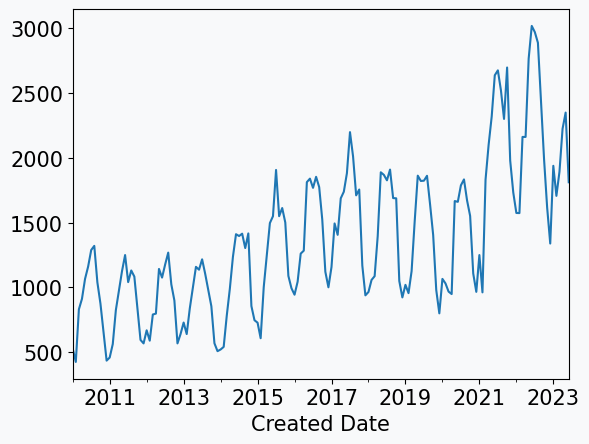

In [261]:
time_complaints.plot()

### I saved and exported it in a ".csv" file.

In [262]:
time_complaints.to_csv('time_complaints.csv')

### Let's plot from 2010, through 2022, since 2023 is not complete.

<Axes: xlabel='Created Date'>

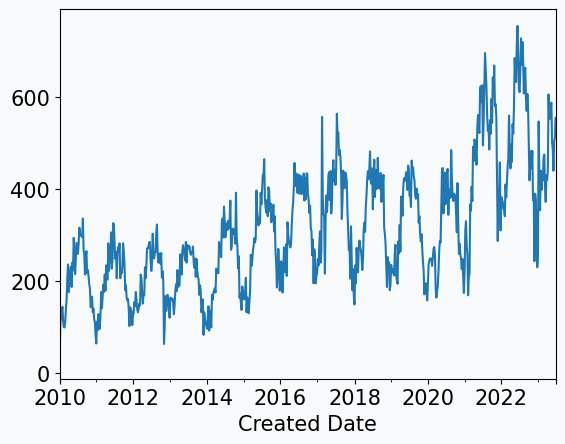

In [258]:
df.resample("W", on="Created Date")["Unique Key"].count().plot()

In [195]:
gb_year_month = df['Created Date'].groupby(df['Created Date'].dt.to_period("M")).agg('count')
gb_year_month

Created Date
2010-01     528
2010-02     425
2010-03     831
2010-04     912
2010-05    1066
2010-06    1161
2010-07    1289
2010-08    1321
2010-09    1040
2010-10     875
2010-11     651
2010-12     435
2011-01     459
2011-02     563
2011-03     825
2011-04     977
2011-05    1126
2011-06    1250
2011-07    1041
2011-08    1131
2011-09    1084
2011-10     835
2011-11     595
2011-12     568
2012-01     669
2012-02     589
2012-03     791
2012-04     798
2012-05    1143
2012-06    1076
2012-07    1177
2012-08    1269
2012-09    1024
2012-10     899
2012-11     568
2012-12     640
2013-01     729
2013-02     640
2013-03     838
2013-04    1001
2013-05    1159
2013-06    1137
2013-07    1217
2013-08    1105
2013-09     981
2013-10     855
2013-11     569
2013-12     508
2014-01     521
2014-02     541
2014-03     782
2014-04     990
2014-05    1236
2014-06    1411
2014-07    1397
2014-08    1415
2014-09    1304
2014-10    1417
2014-11     856
2014-12     747
2015-01     728
2015-02    

In [196]:
gb_year_month.to_csv('complains_gb_year_month.csv')

In [147]:
# df = pd.DataFrame({'datetime': pd.date_range('2023-02-01', periods=10)})
# df['month'] = df['datetime'].dt.month
# df

In [148]:
# a = gb_year_month.groupby(df['Created Date']=='M')
# a

In [76]:
# Other way: gb_year_month.resample("M").count()

In [87]:
# .plot(kind='barh', figsize=(7,5))

In [41]:
# Add a column after a "groupby"
# date = df['Created Date']
# year_borough['date'] = date
# year_borough